In [1]:
!pip install yahoo_fin
import yahoo_fin.stock_info as si
import yfinance as yf
import os
import datetime
import hvplot.pandas
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error


Defaulting to user installation because normal site-packages is not writeable


In [2]:
# Set the start and end dates for the data
start_date = "2014-02-01"
end_date = "2024-02-01"

In [3]:
# Set the list of assets
assets = ["^TNX", "^TYX", "AAPL", "ABBV", "AMZN", "BAC", "BRK-B", "CVX", "GOOG", "GOOGL", "HD", "JNJ", "JPM", "KO", "LLY", "MA", "META", "MRK", "MSFT", "NVDA", "PEP", "PFE", "PG", "TSLA", "UNH", "V", "XOM", "BTC-USD", "ETH-USD"]


In [4]:
#Downloading 10 years of data from yahoo finance.
assets_data = yf.download(assets, period="10y")

[*********************100%%**********************]  29 of 29 completed


In [5]:
# Loop through the assets and get the data for each one
for asset in assets:
  data = si.get_data(asset, start_date=start_date, end_date=end_date)
  # Rename the first column to "Date"
  data.rename(columns={data.columns[0]: "Date"}, inplace=True)
  data = data.reset_index()
  data = data.drop(columns=['ticker'], axis=1)
  data = data.rename(columns={'index': 'Date', 'open': 'Open', 'high': 'High', 'low': 'Low', 'close': 'Close', 'adjclose': 'Adj Close', 'volume': 'Volume'})
  data = data.set_index('Date')
  # From the Data frame Print the Column names
  print(f"Column names for {asset}: {data.columns}")
  # Set the order of the Columns
  columns = ['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume']
 

Column names for ^TNX: Index(['High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Column names for ^TYX: Index(['High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Column names for AAPL: Index(['High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Column names for ABBV: Index(['High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Column names for AMZN: Index(['High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Column names for BAC: Index(['High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Column names for BRK-B: Index(['High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Column names for CVX: Index(['High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Column names for GOOG: Index(['High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Column names for GOOGL: Index(['High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Column names for HD: Index(['High', 'Low', 'Close', 'Adj Clo

In [6]:
directory = 'asset_historical_prices'

# Check if the directory exists
if not os.path.exists(directory):
    # If it doesn't exist, create it
    os.makedirs(directory)

# Save the data to a CSV file
    filename = os.path.join(directory, f"{asset}.csv")
    data.to_csv(filename, index=True, columns=columns) 
    
print("Done!")  

Done!


In [7]:
#putting stock data into a df called closing_prices
closing_prices = pd.DataFrame(assets_data["Adj Close"].dropna(how="all"))
closing_prices

#drop any NAN values that continue to appear
closing_prices = closing_prices.dropna()
closing_prices

,AAPL,ABBV,AMZN,BAC,BRK-B,BTC-USD,CVX,ETH-USD,GOOG,GOOGL,...,NVDA,PEP,PFE,PG,TSLA,UNH,V,XOM,^TNX,^TYX
Date,,,,,,,,,,,,,,,,,,,,,
2017-11-09,41.376930,72.378578,56.456501,22.772854,184.490005,7143.580078,88.787300,320.884003,51.563000,52.386002,...,50.751923,92.314125,26.237970,74.242287,20.199333,192.305252,107.272438,61.290359,2.331,2.806
2017-11-10,41.239979,72.031357,56.267502,22.790052,183.679993,6618.140137,88.741867,299.252991,51.403500,52.207500,...,53.426472,93.365791,26.223059,74.563690,20.199333,191.859863,107.023697,61.098858,2.400,2.880
2017-11-13,41.074715,71.797371,56.458500,22.695484,184.399994,6559.490234,88.779732,316.716003,51.287498,52.060001,...,52.558861,94.434013,26.312506,75.274124,21.026667,193.305145,106.564545,61.061993,2.400,2.869
2017-11-14,40.453758,71.518097,56.841999,22.557938,183.339996,6635.750000,88.544960,337.631012,51.299999,52.082001,...,52.941994,95.858307,26.372137,75.164185,20.580000,192.441666,107.119370,60.583176,2.381,2.839
2017-11-15,39.920181,70.770836,56.334499,23.030760,181.809998,7315.540039,88.189026,333.356995,51.045502,51.820499,...,51.903812,95.311760,26.357229,74.622894,20.753332,190.760010,105.464447,59.824409,2.335,2.781
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-03-06,169.119995,181.059998,173.509995,35.419998,403.959991,66106.804688,148.330002,3819.226318,132.559998,131.399994,...,887.000000,163.000000,27.190001,159.570007,176.539993,470.744293,280.429993,106.769997,4.104,4.240
2024-03-07,169.000000,180.570007,176.820007,35.630001,402.390015,66925.484375,149.369995,3874.347656,135.240005,134.380005,...,926.690002,163.110001,26.790001,160.619995,178.649994,476.899994,278.260010,107.370003,4.092,4.248
2024-03-08,170.729996,178.850006,175.350006,35.599998,403.149994,68300.093750,149.880005,3892.061035,136.289993,135.410004,...,875.280029,163.050003,27.219999,160.350006,175.339996,476.570007,280.040009,108.379997,4.089,4.262


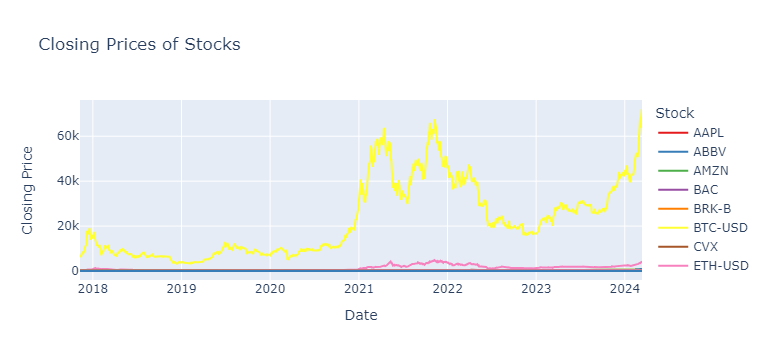

In [8]:
# Reset index if the date is in the index
closing_prices.reset_index(inplace=True)

# Create an interactive line chart with color
fig = px.line(closing_prices, x='Date', y=closing_prices.columns[1:], title='Closing Prices of Stocks',
              labels={'value': 'Closing Price', 'variable': 'Stock'},
              line_shape="linear", render_mode="svg",
              color_discrete_sequence=px.colors.qualitative.Set1)

# Show the figure
fig.show()


In [9]:
# Set the list of assets
assets = ["AAPL", "ABBV", "AMZN", "BAC", "CVX", "GOOG", "JNJ", "KO", "MA", "MSFT", "NVDA", "PEP", "PG", "TSLA", "V", "BRK-B", "BTC-USD", "ETH-USD", "PFE", "UNH", "XOM", "^TNX", "^TYX"]

# Download historical data
assets_data = yf.download(assets, period="10y", group_by='ticker')

# List to store MSE values and corresponding stock symbols
mse_list = []

# Extract features and target variable for each stock
for stock in assets:
    features = assets_data[stock]['Adj Close'].shift(1)  # Use the previous day's adjusted closing price as a feature
    target = assets_data[stock]['Adj Close']

    # Drop NaN values introduced by the shift operation
    data = pd.concat([features, target], axis=1).dropna()

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(data.iloc[:-1, :-1], data.iloc[:-1, -1], test_size=0.2, random_state=42)

    # Initialize the linear regression model
    model = LinearRegression()

    # Fit the model to the training data
    model.fit(X_train.values.reshape(-1, 1), y_train)

    # Make predictions on the test set
    predictions = model.predict(X_test.values.reshape(-1, 1))

    # Evaluate the model performance
    mse = mean_squared_error(y_test, predictions)

    # Append MSE value and stock symbol to the list
    mse_list.append((stock, mse))

# Sort the list of tuples based on MSE values
sorted_mse_list = sorted(mse_list, key=lambda x: x[1])

# Print the sorted MSE values
for stock, mse in sorted_mse_list:
    print(f'Mean Squared Error for {stock}: {mse}')


[*********************100%%**********************]  23 of 23 completed
Mean Squared Error for ^TYX: 0.002630175837371982
Mean Squared Error for ^TNX: 0.002931603667575591
Mean Squared Error for KO: 0.18459560264034697
Mean Squared Error for PFE: 0.1953932764899785
Mean Squared Error for BAC: 0.22891908347131207
Mean Squared Error for XOM: 1.105816168535511
Mean Squared Error for PG: 1.1582140391663782
Mean Squared Error for PEP: 1.4439679975478514
Mean Squared Error for ABBV: 1.4918988325898552
Mean Squared Error for JNJ: 1.6672093603102582
Mean Squared Error for GOOG: 2.78820744164894
Mean Squared Error for CVX: 2.803784763083689
Mean Squared Error for AAPL: 2.9688498866392106
Mean Squared Error for V: 4.972280120728053
Mean Squared Error for AMZN: 6.086393172782106
Mean Squared Error for BRK-B: 6.853737351850579
Mean Squared Error for MSFT: 9.653900431345308
Mean Squared Error for MA: 14.494072975611166
Mean Squared Error for UNH: 21.287529365925046
Mean Squared Error for TSLA: 22.98

[*********************100%%**********************]  23 of 23 completed


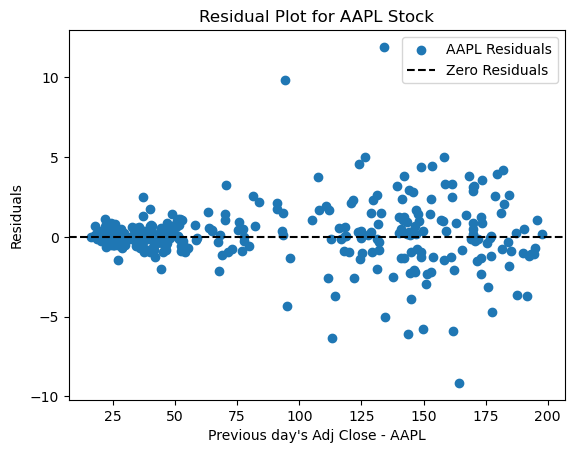

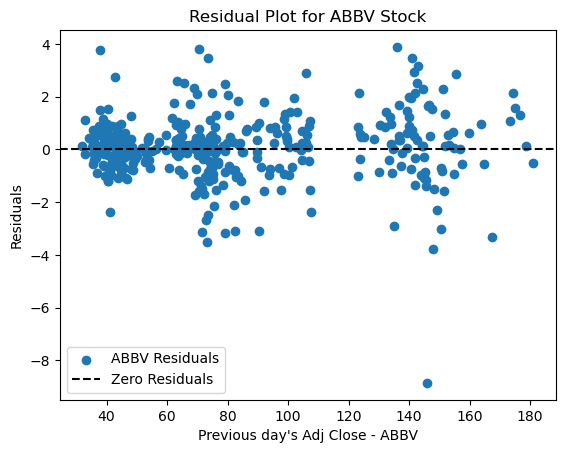

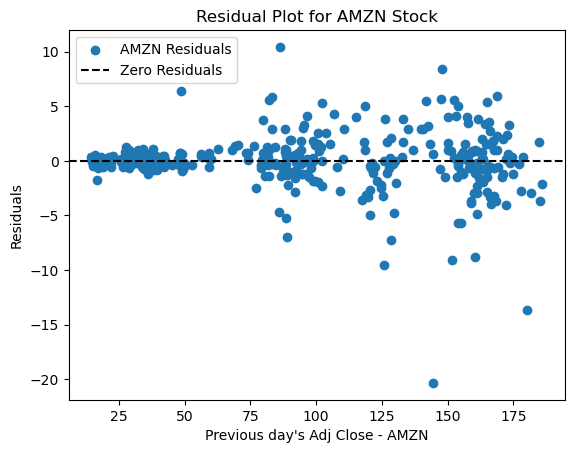

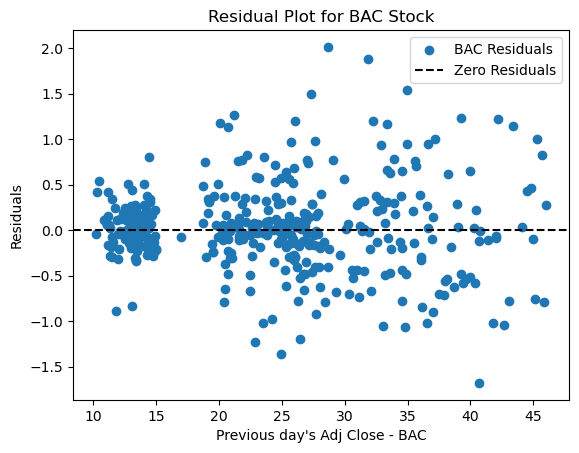

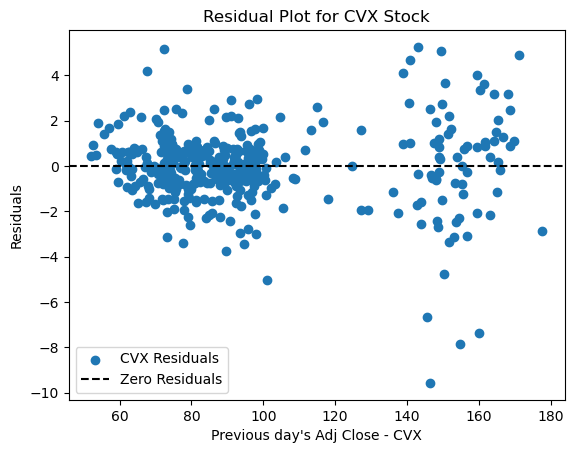

...

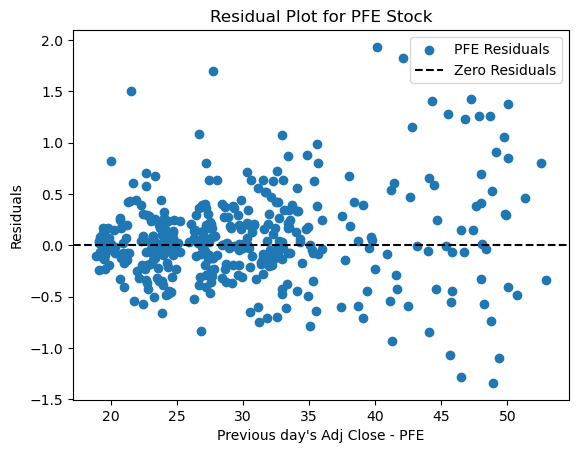

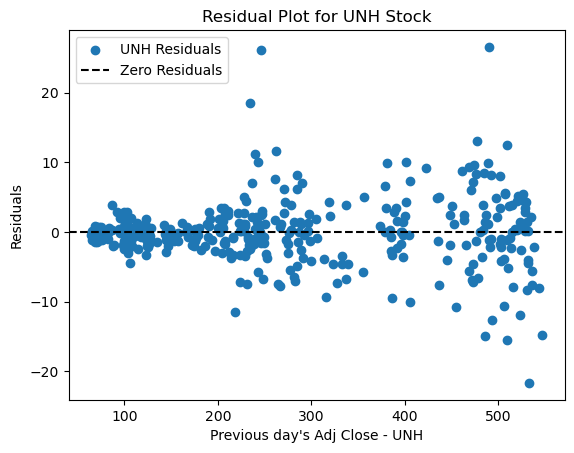

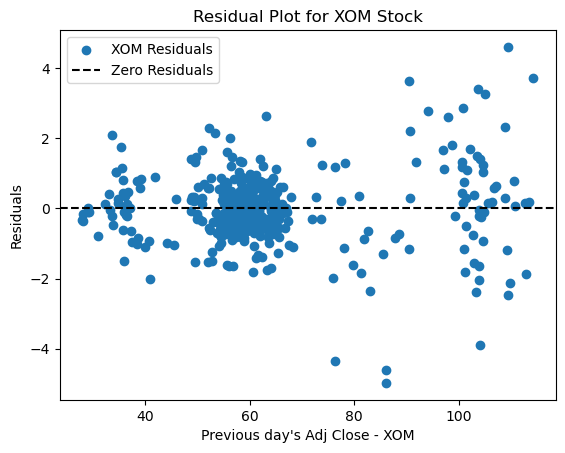

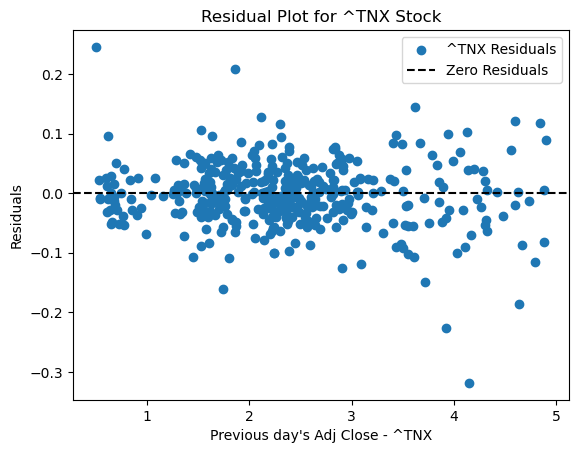

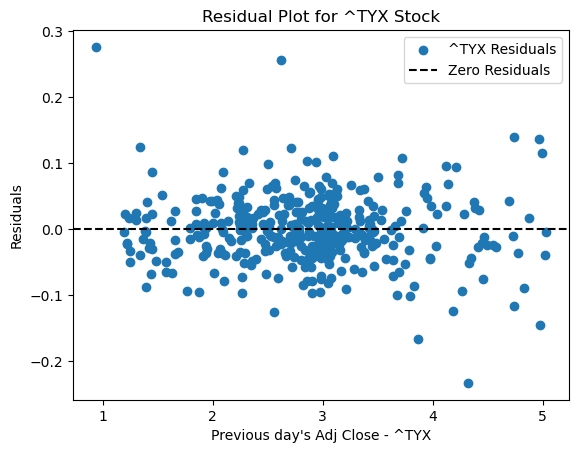

In [10]:
# Set the list of assets
assets = ["AAPL", "ABBV", "AMZN", "BAC", "CVX", "GOOG", "JNJ", "KO", "MA", "MSFT", "NVDA", "PEP", "PG", "TSLA", "V", "BRK-B", "BTC-USD", "ETH-USD", "PFE", "UNH", "XOM", "^TNX", "^TYX"]

# Download historical data
assets_data = yf.download(assets, period="10y", group_by='ticker')

# Initialize the linear regression model
model = LinearRegression()

# Loop through each stock
for stock in assets:
    # Extract features and target variable
    features = assets_data[stock]['Adj Close'].shift(1)  # Use the previous day's adjusted closing price as a feature
    target = assets_data[stock]['Adj Close']

    # Drop NaN values introduced by the shift operation
    data = pd.concat([features, target], axis=1).dropna()

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(data.iloc[:-1, :-1], data.iloc[:-1, -1], test_size=0.2, random_state=42)

    # Fit the model to the training data
    model.fit(X_train.values.reshape(-1, 1), y_train)

    # Make predictions on the test set
    predictions = model.predict(X_test.values.reshape(-1, 1))
    

    # Residual plot
    residuals = y_test - predictions
    plt.scatter(X_test, residuals, label=f'{stock} Residuals')
    plt.axhline(y=0, color='black', linestyle='--', label='Zero Residuals')
    plt.xlabel(f'Previous day\'s Adj Close - {stock}')
    plt.ylabel('Residuals')
    plt.title(f'Residual Plot for {stock} Stock')
    plt.legend()
    plt.show()



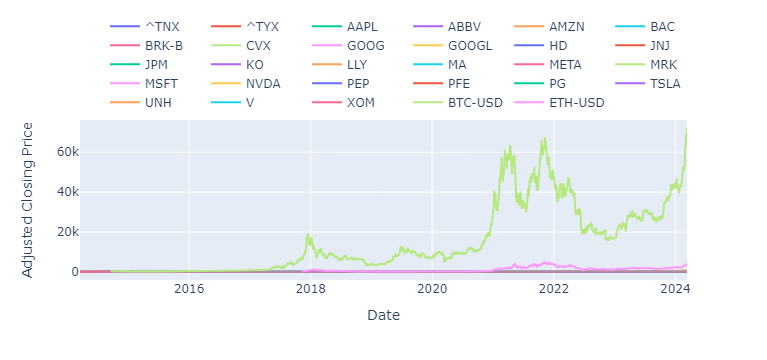

In [27]:
# Set the list of assets
assets = ["^TNX", "^TYX", "AAPL", "ABBV", "AMZN", "BAC", "BRK-B", "CVX", "GOOG", "GOOGL", "HD", "JNJ", "JPM", "KO", "LLY", "MA", "META", "MRK", "MSFT", "NVDA", "PEP", "PFE", "PG", "TSLA", "UNH", "V", "XOM", "BTC-USD", "ETH-USD"]

# Set the end date as today
end_date = datetime.datetime.today().strftime('%Y-%m-%d')

# Calculate the start date by subtracting 10 years from today
start_date = (datetime.datetime.today() - datetime.timedelta(days=365 * 10)).strftime('%Y-%m-%d')

# Download historical data from Yahoo Finance
assets_data = yf.download(assets, start=start_date, end=end_date, progress=False)

# Create an interactive plot using Plotly
fig = go.Figure()

for asset in assets:
    fig.add_trace(go.Scatter(x=assets_data.index, y=assets_data['Adj Close'][asset], mode='lines', name=asset))

# Add layout information
fig.update_layout(

    xaxis=dict(title='Date'),
    yaxis=dict(title='Adjusted Closing Price'),
    legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1)
)

# Show the interactive plot
fig.show()


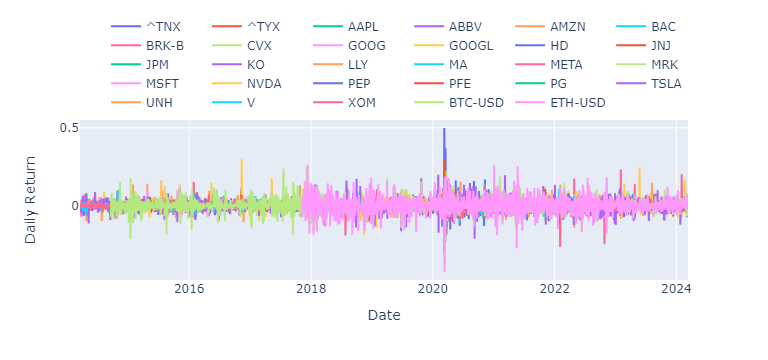

In [37]:
# Set the list of assets
assets = ["^TNX", "^TYX", "AAPL", "ABBV", "AMZN", "BAC", "BRK-B", "CVX", "GOOG", "GOOGL", "HD", "JNJ", "JPM", "KO", "LLY", "MA", "META", "MRK", "MSFT", "NVDA", "PEP", "PFE", "PG", "TSLA", "UNH", "V", "XOM", "BTC-USD", "ETH-USD"]

# Set the end date as today
end_date = datetime.datetime.today().strftime('%Y-%m-%d')

# Calculate the start date by subtracting 10 years from today
start_date = (datetime.datetime.today() - datetime.timedelta(days=365 * 10)).strftime('%Y-%m-%d')

# Download historical data from Yahoo Finance
assets_data = yf.download(assets, start=start_date, end=end_date, progress=False)

# Calculate daily returns
daily_returns = assets_data['Adj Close'].pct_change()

# Create an interactive plot using Plotly for daily returns
fig = go.Figure()

for asset in assets:
    fig.add_trace(go.Scatter(x=daily_returns.index, y=daily_returns[asset], mode='lines', name=asset))

# Add layout information
fig.update_layout(
    xaxis=dict(title='Date'),
    yaxis=dict(title='Daily Return'),
    legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1)
)

# Show the interactive plot
fig.show()

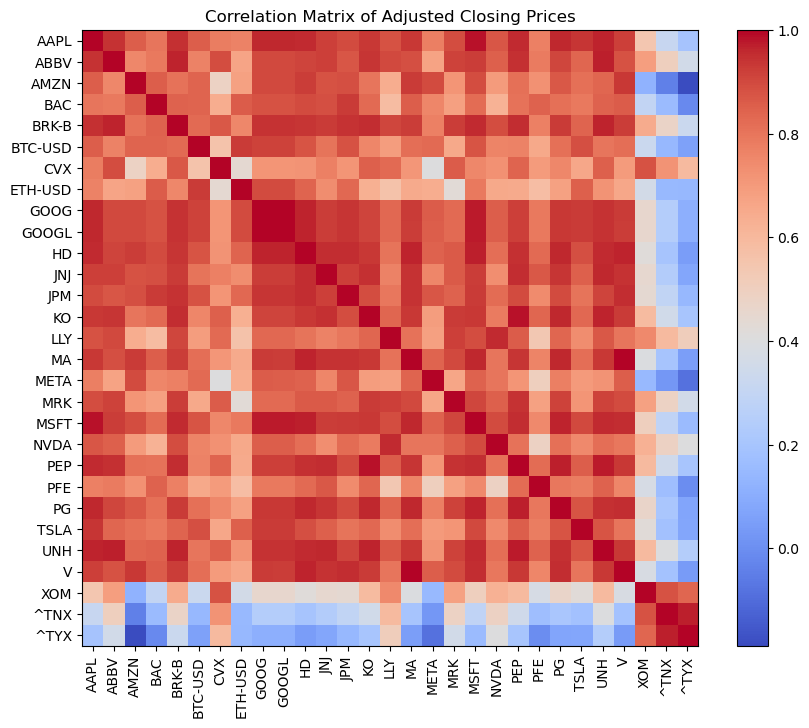

In [34]:
# Plotting a correlation matrix
correlation_matrix = assets_data['Adj Close'].corr()
plt.figure(figsize=(10, 8))
plt.imshow(correlation_matrix, cmap='coolwarm', interpolation='none')
plt.colorbar()
plt.xticks(range(len(correlation_matrix)), correlation_matrix.columns, rotation='vertical')
plt.yticks(range(len(correlation_matrix)), correlation_matrix.columns)
plt.title('Correlation Matrix of Adjusted Closing Prices')
plt.show()


In [33]:
# Accessing correlation between specific stocks
correlation_matrix = assets_data['Adj Close'].corr()

# Print correlation coefficients for specific pairs of stocks
print("Correlation between AAPL and MSFT:", correlation_matrix.loc['AAPL', 'MSFT'])
print("Correlation between AMZN and GOOG:", correlation_matrix.loc['AMZN', 'GOOG'])


Correlation between AAPL and MSFT: 0.983912967821151
Correlation between AMZN and GOOG: 0.9002943093550689


In [14]:
# Set the start and end dates for the data(10 year window)
start_date = "2014-02-02"
end_date = "2024-02-01"

In [15]:
# Defining the assets 
assets = ["^TNX", "^TYX", "AAPL", "ABBV", "AMZN", "BAC", "BRK-B", "CVX", "GOOG", "GOOGL", "HD", "JNJ", "JPM", "KO", "LLY", "MA", "META", "MRK", "MSFT", "NVDA", "PEP", "PFE", "PG", "TSLA", "UNH", "V", "XOM", "BTC-USD", "ETH-USD"]

In [16]:
 # Calculate past volatility 
returns = assets_data.pct_change()
volatility = returns.std() * np.sqrt(252) 

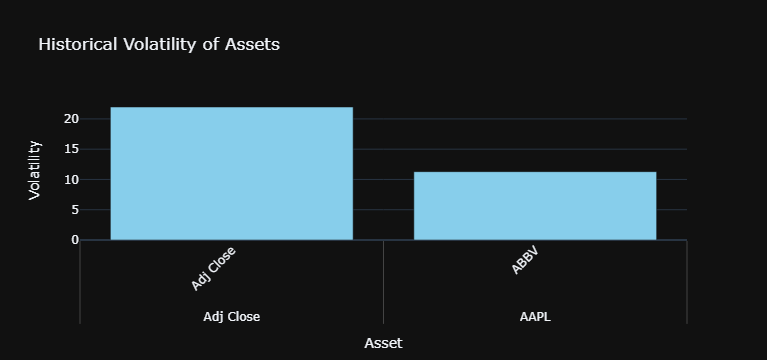

In [17]:
#SAME CHART YOU CAN PICK---Historical Volatility of Assets
fig = go.Figure()

fig.add_trace(go.Bar(x=volatility.index, y=volatility.sort_values(ascending=False), marker_color='skyblue'))

fig.update_layout(
    title='Historical Volatility of Assets',
    xaxis=dict(title='Asset'),
    yaxis=dict(title='Volatility'),
    xaxis_tickangle=-45,
    showlegend=False,  # Since there's only one trace, legend is not necessary
    template="plotly_dark"
)

fig.show()


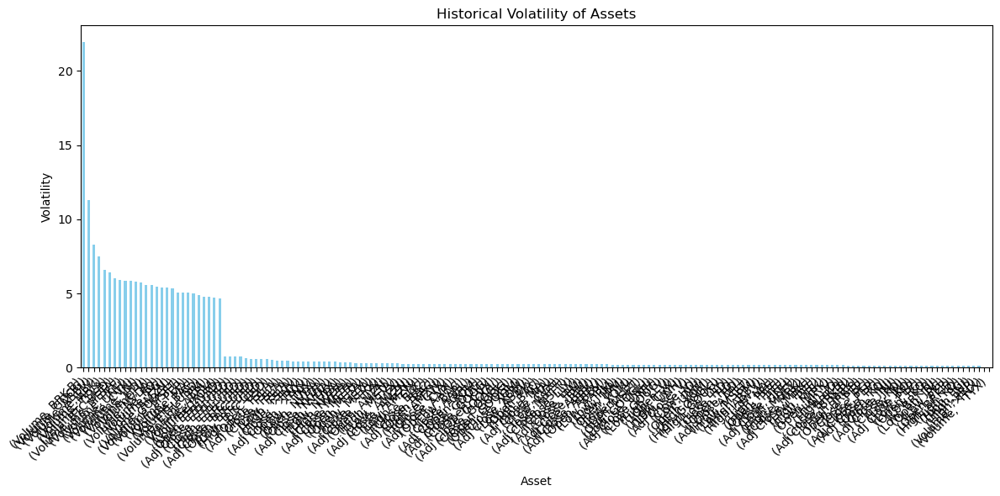

In [18]:
#SAME CHART YOU CAN PICK --- Historical Volatility of Assets
# Plot historical volatility
plt.figure(figsize=(12, 6))
volatility.sort_values(ascending=False).plot(kind='bar', color='skyblue')
plt.title('Historical Volatility of Assets')
plt.xlabel('Asset')
plt.ylabel('Volatility')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [19]:
rolling_mean = assets_data.rolling(window=50, min_periods=1).mean()
rolling_std = assets_data.rolling(window=50, min_periods=1).std()

In [20]:
#SAME CHART YOU CAN PICK---Rolling Mean of Asset Prices

plt.figure(figsize=(12, 6))
for asset in assets:
    plt.plot(rolling_mean.index, rolling_mean[asset], label=asset)
plt.title('Rolling Mean of Asset Prices (Window = 50)')
plt.xlabel('Date')
plt.ylabel('Rolling Mean')
plt.legend()
plt.grid(True)
plt.show() 

KeyError: '^TNX'

<Figure size 1200x600 with 0 Axes>

In [21]:
#SAME CHART YOU CAN PICK----Rolling Mean of Asset Prices
fig = go.Figure()

for asset in assets:
    fig.add_trace(go.Scatter(x=rolling_mean.index, y=rolling_mean[asset], mode='lines', name=asset))

fig.update_layout(
    title='Rolling Mean of Asset Prices (Window = 50)',
    xaxis=dict(title='Date'),
    yaxis=dict(title='Rolling Mean'),
    legend=dict(orientation="h"),
    showlegend=True,
    template="plotly_dark"
)

fig.show()


KeyError: '^TNX'

In [22]:
# Calculate cumulative returns
cumulative_returns = (1 + returns).cumprod() - 1


In [23]:
# Plot cumulative returns
cumulative_returns.hvplot(title='Cumulative Returns of Assets', xlabel='Date', ylabel='Cumulative Returns', width=800, height=400)


DataError: Having a non-string as a column name in a DataFrame is not supported.

In [ ]:
# Calculate Sharpe ratio
risk_free_rate = 0.03  
sharpe_ratio = (returns.mean() - risk_free_rate) / returns.std()


In [ ]:
# Plot Sharpe ratio
sharpe_ratio.hvplot(kind='bar', color='hotpink', title='Sharpe Ratio of Assets', xlabel='Asset', ylabel='Sharpe Ratio', rot=45, width=800, height=400)